<a id="TOP"> </a>
<div class="alert alert-box alert-info">
</div>

***

# EXPLORE

In [2]:
import pandas as pd
import numpy as np
from IPython.display import display, Markdown, Latex

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

from wrangle import clean_zillow, summarize, split_data_continuous
from viz import get_viz

import warnings
warnings.filterwarnings("ignore")

In [3]:
get_viz()


from viz import boxplots, hists, heatmaps, slicer, haversine
        


In [4]:
from viz import boxplots, hists, heatmaps, slicer, haversine

In [5]:
from scipy.stats import pearsonr, spearmanr

In [6]:
from formating import get_formating

In [7]:
get_formating()


from formating import bold, underline, strike, hr, percent
        


In [8]:
from formating import bold, underline, strike, hr, percent

In [9]:
df = clean_zillow()

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 25 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    41067 non-null  int64  
 1   parcel                41067 non-null  int64  
 2   logerror              41067 non-null  float64
 3   bathrooms             41067 non-null  object 
 4   bedrooms              41067 non-null  object 
 5   tot_sqft              41067 non-null  float64
 6   fips                  41067 non-null  object 
 7   hot_tub               41067 non-null  float64
 8   lat                   41067 non-null  float64
 9   lon                   41067 non-null  float64
 10  lot_sqft              41067 non-null  float64
 11  pools                 41067 non-null  int64  
 12  county_landuse        41067 non-null  object 
 13  raw_tract_and_block   41067 non-null  float64
 14  city_id               41067 non-null  object 
 15  zip_code           

In [10]:
train, validate, test = split_data_continuous(df, with_baseline=True, target='rsle')

Prepared df: (41067, 25)

Train: (24639, 25)
Validate: (8214, 25)
Test: (8214, 25)
The mean_preds had the lowest RMSE: 447296 with an in/out of: 1.018


In [11]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24639 entries, 22185 to 21732
Data columns (total 26 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    24639 non-null  int64  
 1   parcel                24639 non-null  int64  
 2   logerror              24639 non-null  float64
 3   bathrooms             24639 non-null  object 
 4   bedrooms              24639 non-null  object 
 5   tot_sqft              24639 non-null  float64
 6   fips                  24639 non-null  object 
 7   hot_tub               24639 non-null  float64
 8   lat                   24639 non-null  float64
 9   lon                   24639 non-null  float64
 10  lot_sqft              24639 non-null  float64
 11  pools                 24639 non-null  int64  
 12  county_landuse        24639 non-null  object 
 13  raw_tract_and_block   24639 non-null  float64
 14  city_id               24639 non-null  object 
 15  zip_code       

In [12]:
num_vars = []
for i in df:
    if df[i].dtype != 'O':
        num_vars.append(i)
num_vars

['id',
 'parcel',
 'logerror',
 'tot_sqft',
 'hot_tub',
 'lat',
 'lon',
 'lot_sqft',
 'pools',
 'raw_tract_and_block',
 'building_tax_value',
 'tax_value',
 'land_tax_value',
 'tax_amount',
 'tax_delinquency_flag',
 'tract_and_block',
 'half_baths',
 'house_age',
 'rsle']

In [13]:
cat_vars = []
for i in df:
    if i not in num_vars:
        cat_vars.append(i)
# cat_vars.append('trans_date')

In [14]:
cat_vars

['bathrooms', 'bedrooms', 'fips', 'county_landuse', 'city_id', 'zip_code']

In [15]:
# num_vars.remove('trans_date')

In [16]:
df[num_vars].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 19 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   id                    41067 non-null  int64  
 1   parcel                41067 non-null  int64  
 2   logerror              41067 non-null  float64
 3   tot_sqft              41067 non-null  float64
 4   hot_tub               41067 non-null  float64
 5   lat                   41067 non-null  float64
 6   lon                   41067 non-null  float64
 7   lot_sqft              41067 non-null  float64
 8   pools                 41067 non-null  int64  
 9   raw_tract_and_block   41067 non-null  float64
 10  building_tax_value    41067 non-null  float64
 11  tax_value             41067 non-null  float64
 12  land_tax_value        41067 non-null  float64
 13  tax_amount            41067 non-null  float64
 14  tax_delinquency_flag  41067 non-null  int64  
 15  tract_and_block    

In [17]:
df['tax_rate'] = df.tax_amount/df.tax_value

In [18]:
# df = df.drop(columns= ['tax_amount', 'tax_value'])

In [19]:
df = df.drop(columns= ['tax_amount'])#, 'tax_value'])

In [20]:
df['acres'] = df.lot_sqft/ 43560
df = df.drop(columns='lot_sqft')

In [21]:
df['structure_dollar_per_sqft'] = df.building_tax_value / df.tot_sqft

In [22]:
# df = df.drop(columns= ['building_tax_value', 'tot_sqft'])

In [23]:
df = df.drop(columns= ['building_tax_value'])#, 'tot_sqft'])

In [24]:
df['land_dollar_per_acre'] = df.land_tax_value / df.acres

df= df.drop(columns= 'land_tax_value')

In [25]:
df.bedrooms.unique()

array(['_4_', '_2_', '_3_', '_5_'], dtype=object)

In [26]:
df.bedrooms = df.bedrooms.map({'_4_':4, '_3_':3, '_2_': 2, '_5_': 5})

In [27]:
df.bathrooms.unique()

array(['_4_', '_1_', '_2_', '_3_', '_5_'], dtype=object)

In [28]:
df.bathrooms = df.bathrooms.map({'_4_':4, '_3_':3, '_2_': 2, '_5_': 5, '_1_':1})

In [29]:
df['bed_bath_ratio'] = df.bedrooms/ df.bathrooms

In [30]:
df= df.drop(columns=['bedrooms','bathrooms'])

In [31]:
df['incity_la'] = df.city_id.apply(lambda x: 1 if x == 12447 else 0)

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id                         41067 non-null  int64  
 1   parcel                     41067 non-null  int64  
 2   logerror                   41067 non-null  float64
 3   tot_sqft                   41067 non-null  float64
 4   fips                       41067 non-null  object 
 5   hot_tub                    41067 non-null  float64
 6   lat                        41067 non-null  float64
 7   lon                        41067 non-null  float64
 8   pools                      41067 non-null  int64  
 9   county_landuse             41067 non-null  object 
 10  raw_tract_and_block        41067 non-null  float64
 11  city_id                    41067 non-null  object 
 12  zip_code                   41067 non-null  object 
 13  tax_value                  41067 non-null  flo

In [33]:
fips = pd.get_dummies(df.fips)

In [34]:
df = pd.concat([df, fips], axis=1)

In [35]:
# df = df.drop(columns='fips')

In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 28 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id                         41067 non-null  int64  
 1   parcel                     41067 non-null  int64  
 2   logerror                   41067 non-null  float64
 3   tot_sqft                   41067 non-null  float64
 4   fips                       41067 non-null  object 
 5   hot_tub                    41067 non-null  float64
 6   lat                        41067 non-null  float64
 7   lon                        41067 non-null  float64
 8   pools                      41067 non-null  int64  
 9   county_landuse             41067 non-null  object 
 10  raw_tract_and_block        41067 non-null  float64
 11  city_id                    41067 non-null  object 
 12  zip_code                   41067 non-null  object 
 13  tax_value                  41067 non-null  flo

In [37]:
df = df.drop(columns= ['city_id', 'zip_code', 'county_landuse', 'tract_and_block', 'half_baths'])#, 'rsle'])

In [38]:
df = df.drop(columns= ['id', 'parcel'])

In [39]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41067 entries, 0 to 41066
Data columns (total 21 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   logerror                   41067 non-null  float64
 1   tot_sqft                   41067 non-null  float64
 2   fips                       41067 non-null  object 
 3   hot_tub                    41067 non-null  float64
 4   lat                        41067 non-null  float64
 5   lon                        41067 non-null  float64
 6   pools                      41067 non-null  int64  
 7   raw_tract_and_block        41067 non-null  float64
 8   tax_value                  41067 non-null  float64
 9   tax_delinquency_flag       41067 non-null  int64  
 10  house_age                  41067 non-null  int64  
 11  rsle                       41067 non-null  float64
 12  tax_rate                   41067 non-null  float64
 13  acres                      41067 non-null  flo

In [40]:
df = df.drop(columns='raw_tract_and_block')

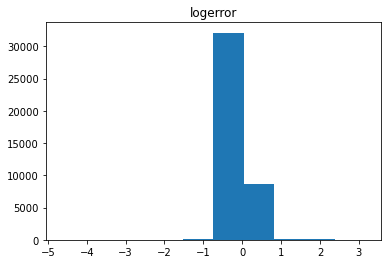

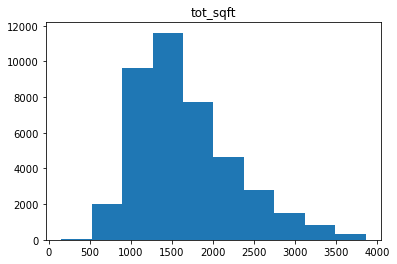

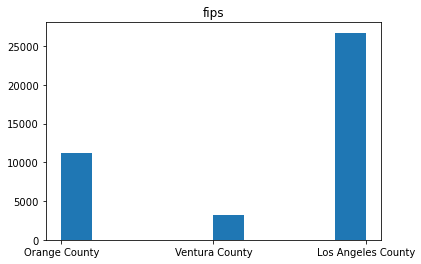

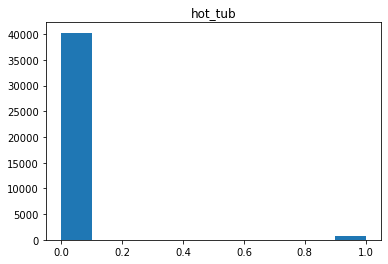

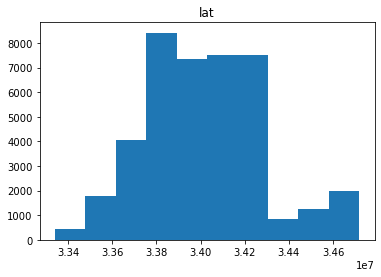

...

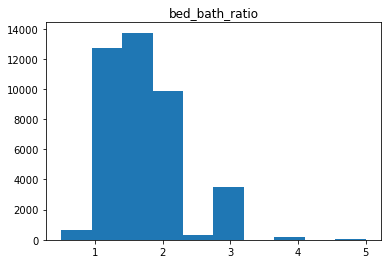

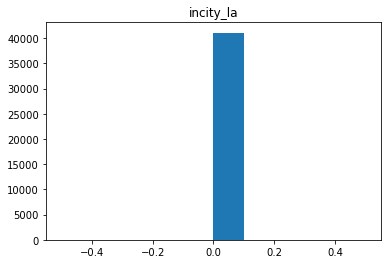

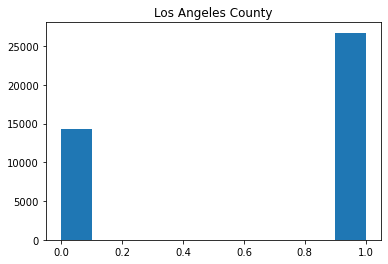

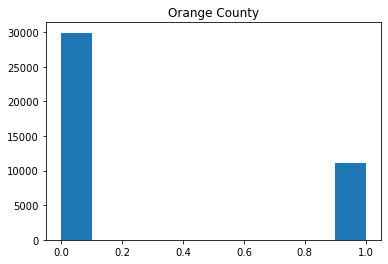

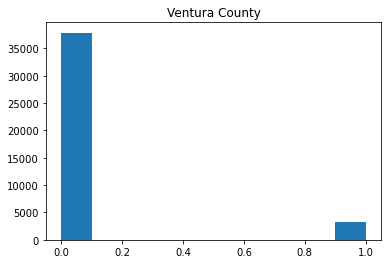

In [41]:
for col in df.columns:
    plt.hist(df[col])
    plt.title(col)
    plt.show()

In [42]:
train, validate, test = split_data_continuous(df, target='logerror')
                                    

Prepared df: (41067, 20)

Train: (24639, 20)
Validate: (8214, 20)
Test: (8214, 20)


In [43]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24639 entries, 22185 to 21732
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   logerror                   24639 non-null  float64
 1   tot_sqft                   24639 non-null  float64
 2   fips                       24639 non-null  object 
 3   hot_tub                    24639 non-null  float64
 4   lat                        24639 non-null  float64
 5   lon                        24639 non-null  float64
 6   pools                      24639 non-null  int64  
 7   tax_value                  24639 non-null  float64
 8   tax_delinquency_flag       24639 non-null  int64  
 9   house_age                  24639 non-null  int64  
 10  rsle                       24639 non-null  float64
 11  tax_rate                   24639 non-null  float64
 12  acres                      24639 non-null  float64
 13  structure_dollar_per_sqft  24639 non-null 

In [44]:
X_train = train.drop(columns=['logerror', 'rsle'])
y_train = train[['logerror', 'rsle']]
X_validate = validate.drop(columns= ['logerror', 'rsle'])
y_validate = validate[['logerror', 'rsle']]
X_test = test.drop(columns= ['logerror', 'rsle'])
y_test = test[['logerror', 'rsle']]

# How does the acreage affect logerror?

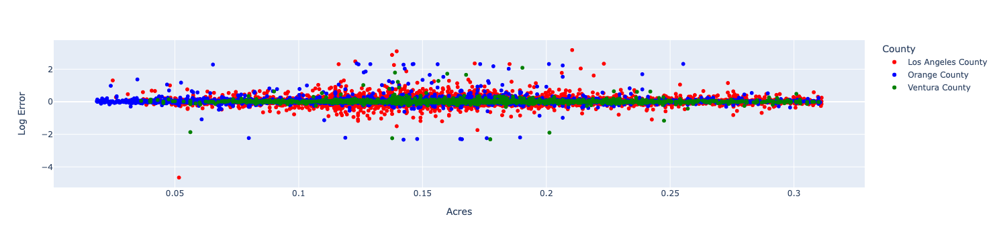

In [45]:
px.scatter(data_frame=train,
                x= train.acres,
                y= 'logerror',
           color= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'logerror': 'Log Error', 'acres': 'Acres', 'fips': 'County'}
           # marginal_x='box'
               )


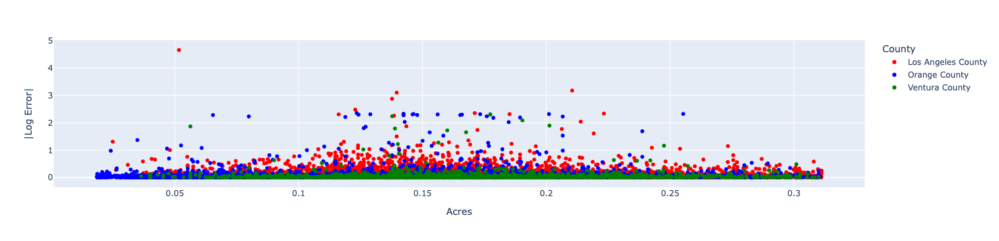

In [46]:
px.scatter(data_frame=train,
                x= train.acres,
                y= 'rsle',
           color= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'rsle': '|Log Error|', 'acres': 'Acres', 'fips': 'County'}
           # marginal_x='box'
               )


In [47]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24639 entries, 22185 to 21732
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   logerror                   24639 non-null  float64
 1   tot_sqft                   24639 non-null  float64
 2   fips                       24639 non-null  object 
 3   hot_tub                    24639 non-null  float64
 4   lat                        24639 non-null  float64
 5   lon                        24639 non-null  float64
 6   pools                      24639 non-null  int64  
 7   tax_value                  24639 non-null  float64
 8   tax_delinquency_flag       24639 non-null  int64  
 9   house_age                  24639 non-null  int64  
 10  rsle                       24639 non-null  float64
 11  tax_rate                   24639 non-null  float64
 12  acres                      24639 non-null  float64
 13  structure_dollar_per_sqft  24639 non-null 

# Is there a relationship between tax rate and logerror... and are hot tubs different?

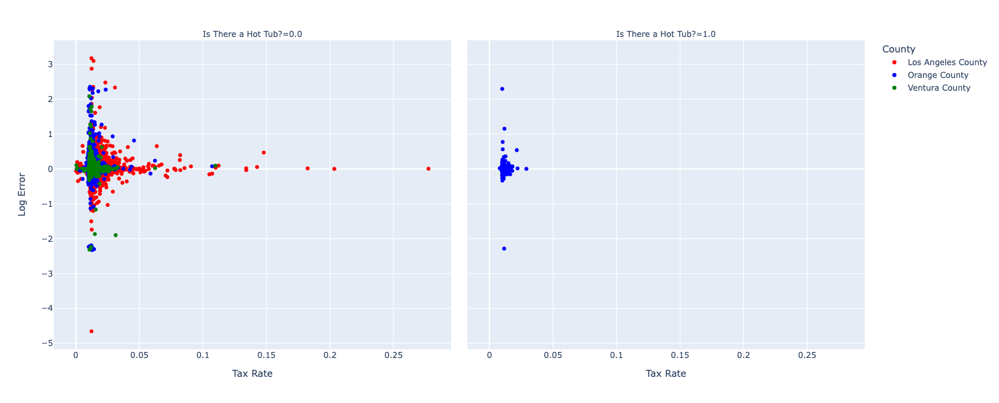

In [48]:
px.scatter(data_frame=train,
                x= train.tax_rate,
                y= 'logerror',
           color='fips',
           facet_col= train.hot_tub,
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'logerror': 'Log Error', 'tax_rate': 'Tax Rate', 'fips': 'County', 'hot_tub':'Is There a Hot Tub?'},
           height=600
               )


# Looks like Hot Tubs are only accounted for in Orange County,<br>should it only be used as a feature in Orange County?

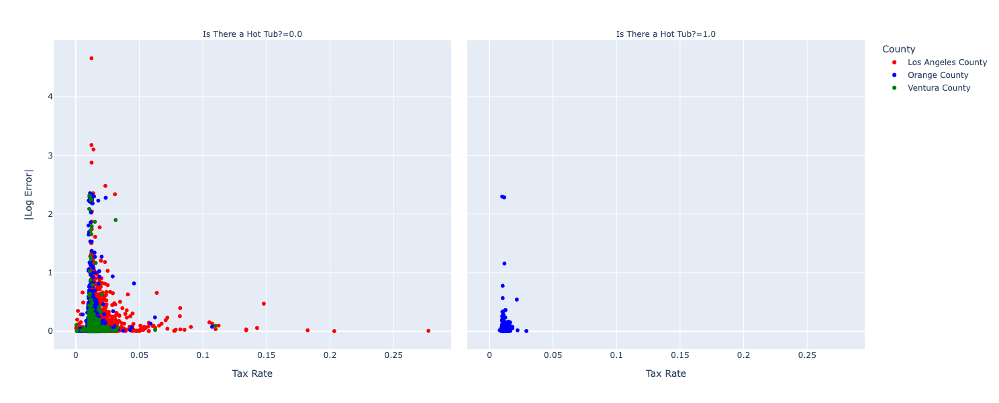

In [49]:
px.scatter(data_frame=train,
                x= train.tax_rate,
                y= 'rsle',
           color='fips',
           facet_col= train.hot_tub,
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'rsle': '|Log Error|', 'tax_rate': 'Tax Rate', 'fips': 'County', 'hot_tub':'Is There a Hot Tub?'},
           height=600
               )


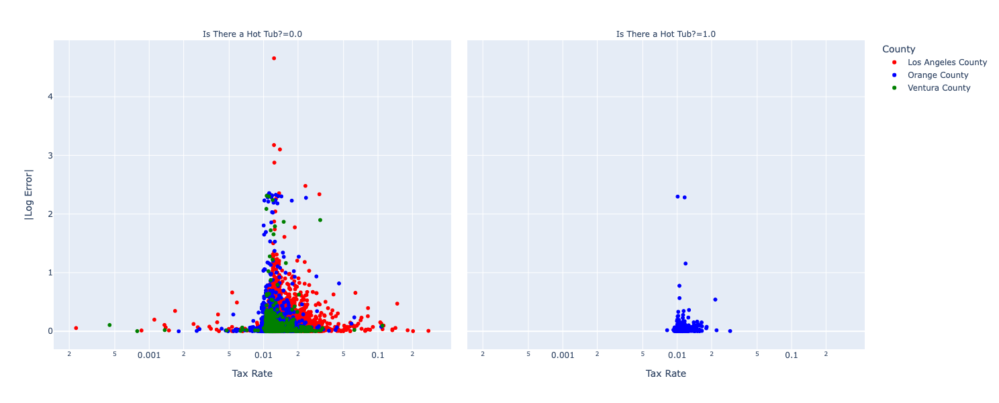

In [50]:
px.scatter(data_frame=train,
                x= train.tax_rate,
                y= 'rsle',
           # log_y=True,
           log_x=True,
           color='fips',
           facet_col= train.hot_tub,
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'rsle': '|Log Error|', 'tax_rate': 'Tax Rate', 'fips': 'County', 'hot_tub':'Is There a Hot Tub?'},
           height=600
               )


# It looks like the higher the Tax Rate, the less the logerror
- We will test this

- Also it looks like houses with hot tubs are taxed at a lower rate

In [51]:
r, p_value = pearsonr(x= train.tax_rate, y= train.logerror)
print(r, p_value)

0.016449963729742823 0.009818289680690907


In [52]:
α = .05

In [53]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: {bold("There is no correlation between Tax Rate and Logerror")}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.02 and p_value of 0.01


# Does the correleation go up if we look at counties individually?

- Also, does it go up if we look at |Log Error|?


In [54]:
lac = train[train.fips == 'Los Angeles County']
oc = train[train.fips == 'Orange County']
vc = train[train.fips == 'Ventura County']

# Los Angeles County

## 1. In county correlation of Tax Rate to Log Error

In [55]:
r, p_value = pearsonr(x= lac.tax_rate, y= lac.logerror)
print(r, p_value)

0.02379725538620701 0.002580679811981757


In [56]:
α = .05

In [57]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.02 and p_value of 0.003


## 2. In county correlation of Tax Rate to | Log Error |

In [58]:
r, p_value = pearsonr(x= lac.tax_rate, y= lac.rsle)
print(r, p_value)

0.02129560072522834 0.007000333579801068


In [59]:
α = .05

In [60]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.02 and p_value of 0.007


# Orange County

## 1. In county correlation of Tax Rate to Log Error

In [61]:
r, p_value = pearsonr(x= oc.tax_rate, y= oc.logerror)
print(r, p_value)

0.03258957318605456 0.007717280184180874


In [62]:
α = .05

In [63]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.03 and p_value of 0.008


## 2. In county correlation of Tax Rate to | Log Error |

In [64]:
r, p_value = pearsonr(x= oc.tax_rate, y= oc.rsle)
print(r, p_value)

0.039689958009666675 0.0011742268759750213


In [65]:
α = .05

In [66]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.04 and p_value of 0.001


# Ventura County

## 1. In county correlation of Tax Rate to Log Error

In [67]:
r, p_value = pearsonr(x= vc.tax_rate, y= vc.logerror)
print(r, p_value)

-0.028616673914129802 0.20995591239331476


In [68]:
α = .05

In [69]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror
    With Correlation coeffiecent of -0.03 and p_value of 0.21


## 2. In county correlation of Tax Rate to | Log Error |

In [70]:
r, p_value = pearsonr(x= vc.tax_rate, y= vc.rsle)
print(r, p_value)

0.052198659847830335 0.02214352829693886


In [71]:
α = .05

In [72]:
if p_value < α:
    print(f'We can REJECT the Null Hₒ: {strike("There is no correlation between Tax Rate and Logerror")}\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')
    
else:
    print(f'We CANNOT reject thr Null Hₒ: There is no correlation between Tax Rate and Logerror\n\
    With Correlation coeffiecent of {round(r,2)} and p_value of {round(p_value,3)}')

We can REJECT the Null Hₒ: T̶h̶e̶r̶e̶ ̶i̶s̶ ̶n̶o̶ ̶c̶o̶r̶r̶e̶l̶a̶t̶i̶o̶n̶ ̶b̶e̶t̶w̶e̶e̶n̶ ̶T̶a̶x̶ ̶R̶a̶t̶e̶ ̶a̶n̶d̶ ̶L̶o̶g̶e̶r̶r̶o̶r̶
    With Correlation coeffiecent of 0.05 and p_value of 0.022


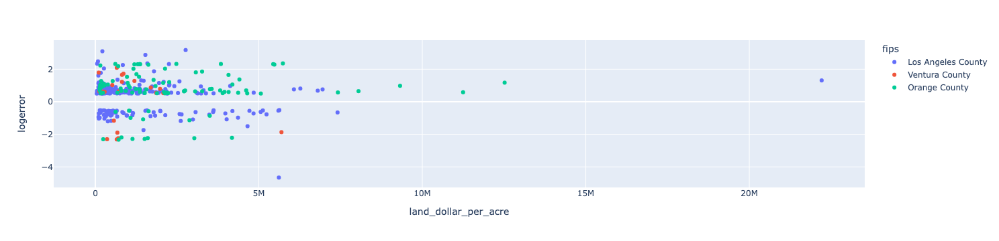

In [73]:
px.scatter(data_frame=train[train.rsle > .5],
           x= 'land_dollar_per_acre',
           y= 'logerror',
           color= 'fips'
          )

In [74]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24639 entries, 22185 to 21732
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   logerror                   24639 non-null  float64
 1   tot_sqft                   24639 non-null  float64
 2   fips                       24639 non-null  object 
 3   hot_tub                    24639 non-null  float64
 4   lat                        24639 non-null  float64
 5   lon                        24639 non-null  float64
 6   pools                      24639 non-null  int64  
 7   tax_value                  24639 non-null  float64
 8   tax_delinquency_flag       24639 non-null  int64  
 9   house_age                  24639 non-null  int64  
 10  rsle                       24639 non-null  float64
 11  tax_rate                   24639 non-null  float64
 12  acres                      24639 non-null  float64
 13  structure_dollar_per_sqft  24639 non-null 

In [75]:
train.lon = train.lon.astype('int')
train.lat = train.lat.astype('int')

In [76]:
train['long'] = train.lon / 1_000_000
train['lati'] = train.lat /1_000_000

In [77]:
train['big_vs_little_error'] = train['rsle']

In [79]:
# for i, j in enumerate(train.rsle):
#     if j >= .5:
#         # print(i,j)
#         train.big_vs_little_error.iloc[i] = 1
#     else:
#         # print('less')
#         train.big_vs_little_error.iloc[i] = 0
        
# train.big_vs_little_error

In [80]:
# train.big_vs_little_error = train.big_vs_little_error.astype('int')

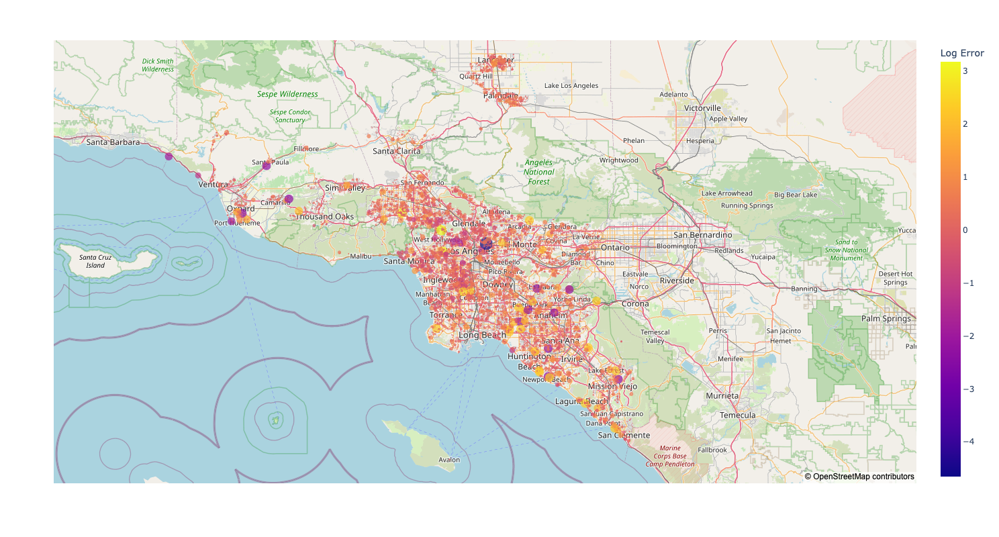

In [81]:
fig = px.scatter_mapbox(data_frame=train,#[train.rsle > .5],
                lon= 'long',
                lat= 'lati',
           color='logerror',
           size='rsle',
                        size_max=14,
           # facet_col= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           # color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'logerror': 'Log Error', 'lat': 'Latitude', 'fips': 'County', 'lon':'Longitude'},
           height=800,
           width=1000
               )
fig.update_layout(mapbox_style="open-street-map", mapbox_zoom=8)
fig.

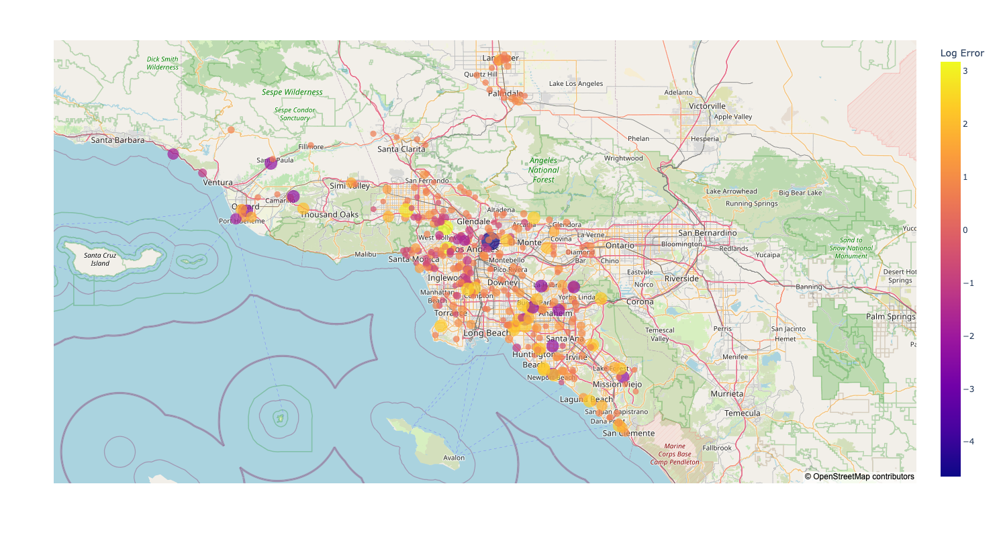

In [82]:
fig = px.scatter_mapbox(data_frame=train[train.rsle > .5],
                lon= 'long',
                lat= 'lati',
           color='logerror',
           size='rsle',
           # facet_col= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           # color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'logerror': 'Log Error', 'lat': 'Latitude', 'fips': 'County', 'lon':'Longitude'},
           height=800,
           width=1000
               )
fig.update_layout(mapbox_style="open-street-map", mapbox_zoom=8)

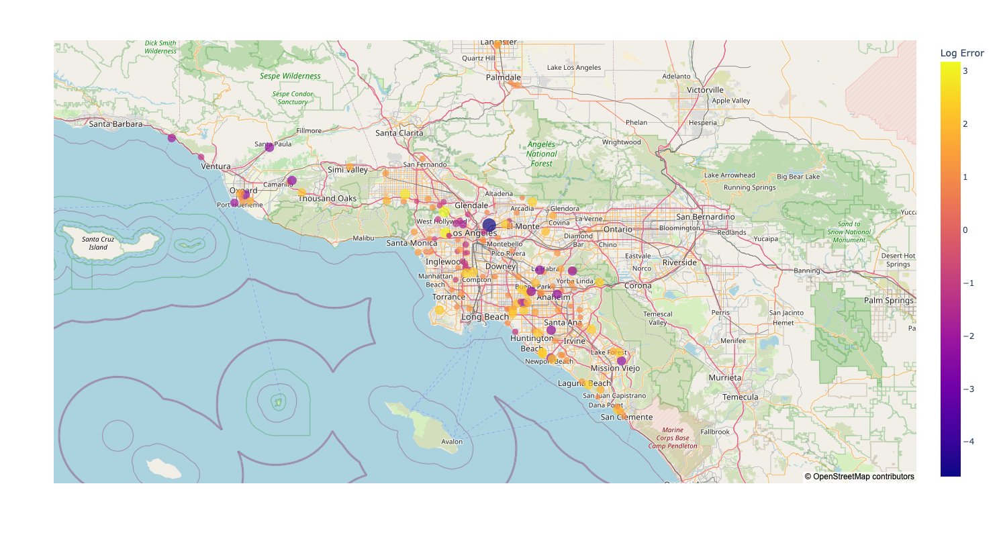

In [83]:
fig = px.scatter_mapbox(data_frame=train[train.rsle > .8],
                lon= 'long',
                lat= 'lati',
           color='logerror',
           size='rsle',
                        size_max= 15,
           # facet_col= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           # color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'logerror': 'Log Error', 'lat': 'Latitude', 'fips': 'County', 'lon':'Longitude'},
           height=800,
           width=1000
               )
fig.update_layout(mapbox_style="open-street-map", mapbox_zoom=8)

In [ ]:
train.lat

In [ ]:
px.scatter(data_frame=train,
           x= 'bed_bath_ratio'
           

In [ ]:
px.scatter(data_frame=train,
                x= 'bed_bath_ratio',
                y= 'rsle',
           # log_y=True,
           # log_x=True,
           color='pools',
           facet_col= 'fips',
           category_orders={'fips':['Los Angeles County', 'Orange County', 'Ventura County']},
           color_discrete_sequence=['red', 'blue', 'green'],
           labels= {'rsle': '|Log Error|', 'tax_rate': 'Tax Rate', 'fips': 'County', 'hot_tub':'Is There a Hot Tub?'},
           height=600
               )


In [ ]:
px.scatter(data_frame=train,
           x= 'building_tax_value',
           y= 'tax_value',
           color= 'logerror')

# If building tax value goes up with tax value we don't need both

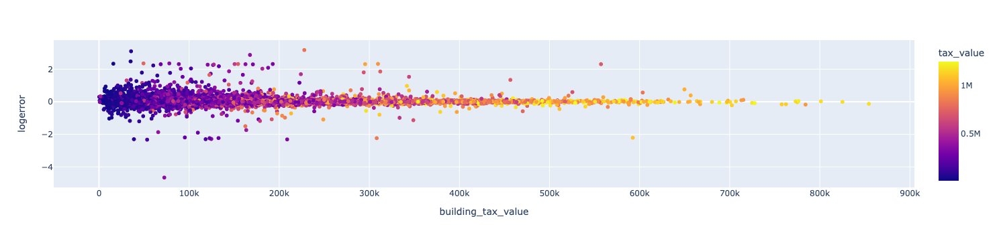

In [22]:
px.scatter(data_frame=train,
           x= 'building_tax_value',
           y= 'logerror',
           color= 'tax_value')